In [2]:
%pip install tensorflow
%pip install keras
%pip install opencv-python

Note: you may need to restart the kernel to use updated packages.
  Obtaining dependency information for tensorflow from https://files.pythonhosted.org/packages/5c/98/d145af334fd5807d6ba1ead447bf0c57a36654ea58e726d70c0d09cae913/tensorflow-2.19.0-cp312-cp312-win_amd64.whl.metadata
  Obtaining dependency information for absl-py>=1.0.0 from https://files.pythonhosted.org/packages/a2/ad/e0d3c824784ff121c03cc031f944bc7e139a8f1870ffd2845cc2dd76f6c4/absl_py-2.1.0-py3-none-any.whl.metadata
  Obtaining dependency information for astunparse>=1.6.0 from https://files.pythonhosted.org/packages/2b/03/13dde6512ad7b4557eb792fbcf0c653af6076b81e5941d36ec61f7ce6028/astunparse-1.6.3-py2.py3-none-any.whl.metadata
  Obtaining dependency information for flatbuffers>=24.3.25 from https://files.pythonhosted.org/packages/b8/25/155f9f080d5e4bc0082edfda032ea2bc2b8fab3f4d25d46c1e9dd22a1a89/flatbuffers-25.2.10-py2.py3-none-any.whl.metadata
  Obtaining dependency information for gast!=0.5.0,!=0.5.1,!=0.5.2,>=0.2.1 

  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.

[notice] A new release of pip is available: 23.2.1 -> 25.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.Requirement already satisfied: keras in c:\users\nikit\appdata\local\programs\python\python312\lib\site-packages (3.9.0)




[notice] A new release of pip is available: 23.2.1 -> 25.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip


  Obtaining dependency information for opencv-python from https://files.pythonhosted.org/packages/a4/7d/f1c30a92854540bf789e9cd5dde7ef49bbe63f855b85a2e6b3db8135c591/opencv_python-4.11.0.86-cp37-abi3-win_amd64.whl.metadata
   ---------------------------------------- 0.0/39.5 MB ? eta -:--:--
   ---------------------------------------- 0.0/39.5 MB ? eta -:--:--
   ---------------------------------------- 0.1/39.5 MB 919.0 kB/s eta 0:00:43
   ---------------------------------------- 0.2/39.5 MB 1.6 MB/s eta 0:00:26
   ---------------------------------------- 0.5/39.5 MB 2.6 MB/s eta 0:00:16
    --------------------------------------- 0.9/39.5 MB 4.1 MB/s eta 0:00:10
   - -------------------------------------- 1.1/39.5 MB 4.6 MB/s eta 0:00:09
   - -------------------------------------- 1.6/39.5 MB 5.3 MB/s eta 0:00:08
   -- ------------------------------------- 2.3/39.5 MB 6.6 MB/s eta 0:00:06
   -- ------------------------------------- 2.4/39.5 MB 6.5 MB/s eta 0:00:06
   -- --------------


[notice] A new release of pip is available: 23.2.1 -> 25.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [3]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import cv2
from keras.applications.vgg16 import VGG16, preprocess_input, decode_predictions
from keras.preprocessing import image
from keras import backend as K
from keras.models import Model
import tensorflow as tf

In [4]:
model = VGG16(weights='imagenet')
img_path = '../data/tree.png'
img = image.load_img(img_path, target_size=(224, 224))
x = image.img_to_array(img)
x = np.expand_dims(x, axis=0)
x = preprocess_input(x)

553467096/553467096 ━━━━━━━━━━━━━━━━━━━━ 56s 0us/step


In [5]:
preds = model.predict(x)
print('Предсказание:', decode_predictions(preds, top=3)[0])
class_idx = np.argmax(preds[0])
print(f"Индекс класса: {class_idx}")

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 826ms/step
35363/35363 ━━━━━━━━━━━━━━━━━━━━ 0s 1us/step
Предсказание: [('n03991062', 'pot', np.float32(0.13222978)), ('n09332890', 'lakeside', np.float32(0.027846714)), ('n04355338', 'sundial', np.float32(0.025308017))]
Индекс класса: 738


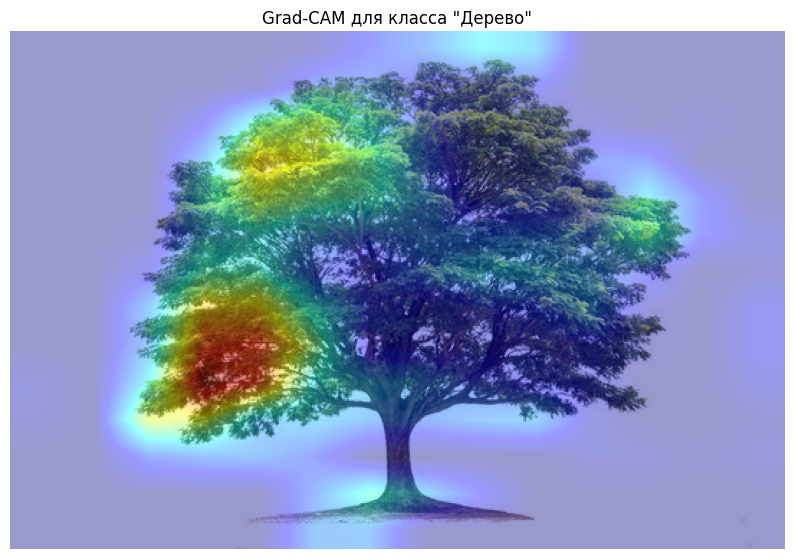

In [ ]:

def generate_grad_cam(model, img_path, class_idx):
    # Загрузка и предобработка изображения
    img = image.load_img(img_path, target_size=(224, 224))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)

    with tf.GradientTape() as tape:
        last_conv_layer = model.get_layer('block5_conv3')
        iterate = tf.keras.models.Model(inputs=model.input, 
                                       outputs=[model.output, last_conv_layer.output])
        model_out, conv_out = iterate(x)
        loss = model_out[:, class_idx]

    grads = tape.gradient(loss, conv_out)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    
    # Вычисление тепловой карты
    conv_out = conv_out[0]
    heatmap = tf.reduce_sum(tf.multiply(conv_out, pooled_grads), axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)
    
    # Наложение на исходное изображение
    img = cv2.imread(img_path)
    heatmap = cv2.resize(np.uint8(heatmap * 255), (img.shape[1], img.shape[0]))
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed_img = cv2.addWeighted(img, 0.6, heatmap, 0.4, 0)
    
    return superimposed_img

superimposed_img = generate_grad_cam(model, img_path, class_idx)
plt.figure(figsize=(10, 10))
plt.imshow(superimposed_img[:, :, ::-1])
plt.title('Grad-CAM для класса "Дерево"')
plt.axis('off')
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


C:\Users\nikit\AppData\Local\Temp\ipykernel_21828\3698710866.py:26: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  plt.imshow(display_grid, aspect='auto', cmap='viridis')


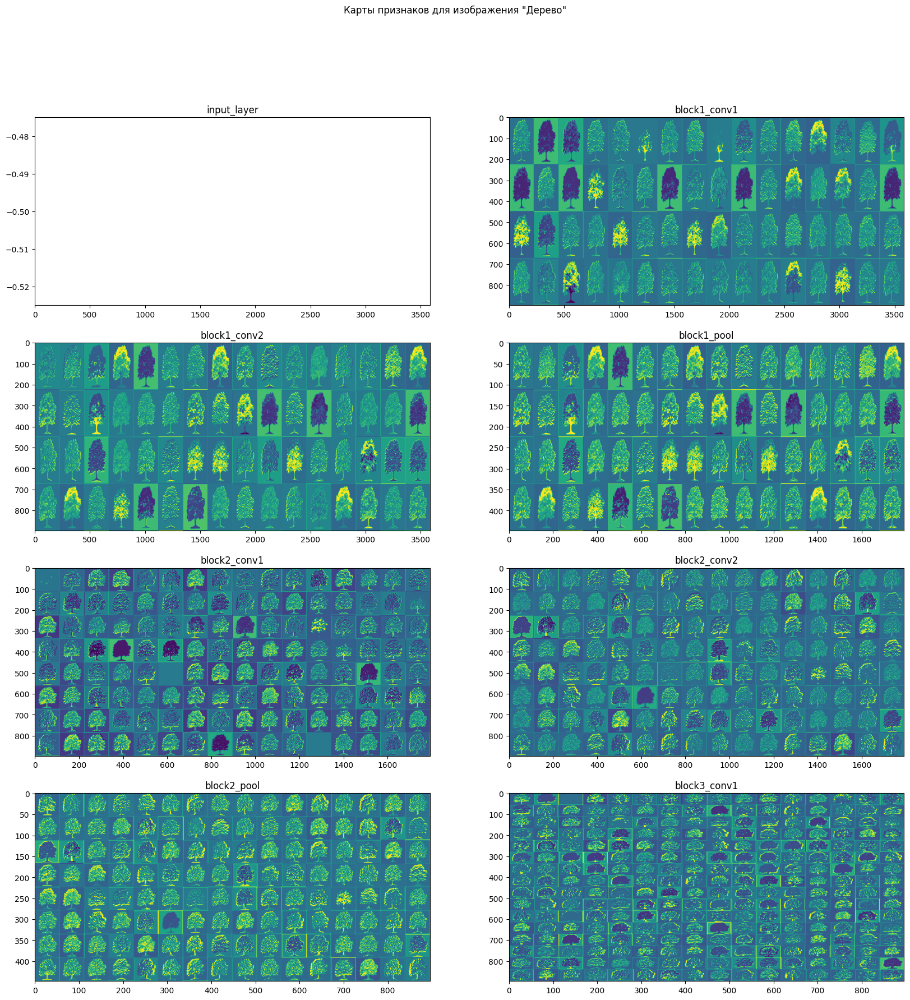

In [7]:
layer_outputs = [layer.output for layer in model.layers[:8]]
activation_model = Model(inputs=model.input, outputs=layer_outputs)

activations = activation_model.predict(x)

plt.figure(figsize=(20, 20))
for i, (layer_name, layer_activation) in enumerate(zip([layer.name for layer in model.layers[:8]], activations)):
    n_features = layer_activation.shape[-1]
    size = layer_activation.shape[1]
    n_cols = n_features // 16
    display_grid = np.zeros((size * n_cols, 16 * size))
    
    for col in range(n_cols):
        for row in range(16):
            channel_image = layer_activation[0, :, :, col * 16 + row]
            channel_image -= channel_image.mean()
            channel_image /= (channel_image.std() + 1e-5)
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size, row * size : (row + 1) * size] = channel_image
    
    plt.subplot(4, 2, i+1)
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')
plt.suptitle('Карты признаков для изображения "Дерево"')
plt.show()

In [8]:
tf.config.experimental_run_functions_eagerly(True)
tf.data.experimental.enable_debug_mode()

Instructions for updating:
Use `tf.config.run_functions_eagerly` instead of the experimental version.


58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 6s 0us/step


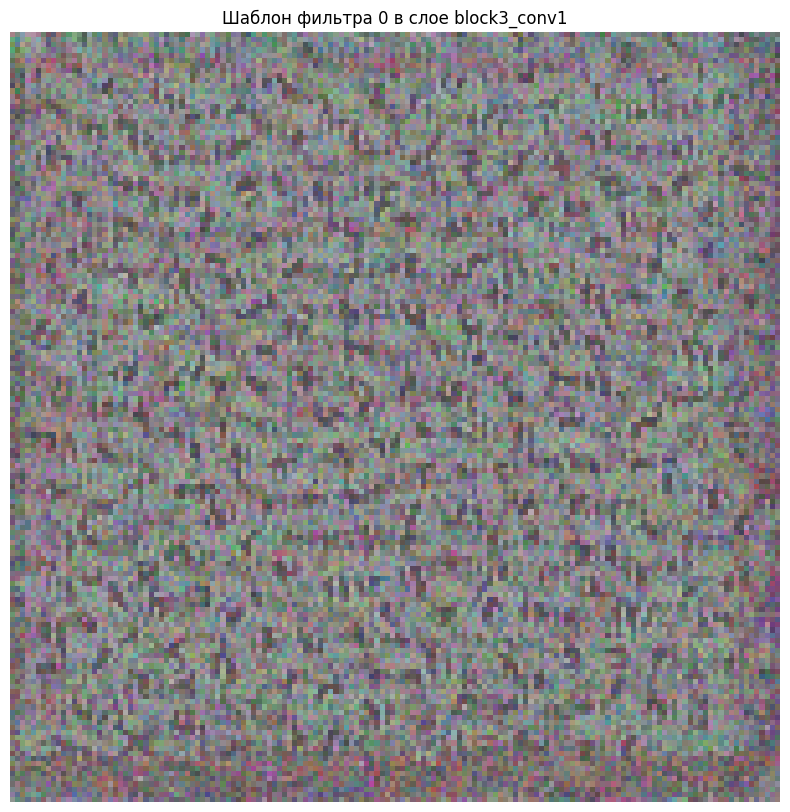

In [9]:
import tensorflow as tf
from tensorflow.keras.applications import VGG16
from tensorflow.keras import backend as K
import numpy as np
import matplotlib.pyplot as plt

model = VGG16(weights='imagenet', include_top=False)

def generate_pattern(layer_name, filter_index, size=150, iterations=40, step=1.0):
    layer = model.get_layer(layer_name)
    
    activation_model = tf.keras.models.Model(
        inputs=model.input,
        outputs=layer.output
    )
    
    def compute_loss(activations):
        return tf.reduce_mean(activations[..., filter_index])
    
    input_img = tf.Variable(np.random.random((1, size, size, 3)).astype('float32') * 20 + 128)
    
    optimizer = tf.keras.optimizers.Adam(learning_rate=step)
    
    for _ in range(iterations):
        with tf.GradientTape() as tape:
            tape.watch(input_img)
            activations = activation_model(input_img)
            loss = compute_loss(activations)
        grads = tape.gradient(loss, input_img)
        optimizer.apply_gradients([(grads, input_img)])
    
    img = input_img.numpy()[0]
    return deprocess_image(img)

def deprocess_image(x):
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1
    x += 0.5
    x = np.clip(x, 0, 1)
    x *= 255
    return np.clip(x, 0, 255).astype('uint8')

plt.figure(figsize=(10, 10))
plt.imshow(generate_pattern('block3_conv1', 0))
plt.title('Шаблон фильтра 0 в слое block3_conv1')
plt.axis('off')
plt.show()

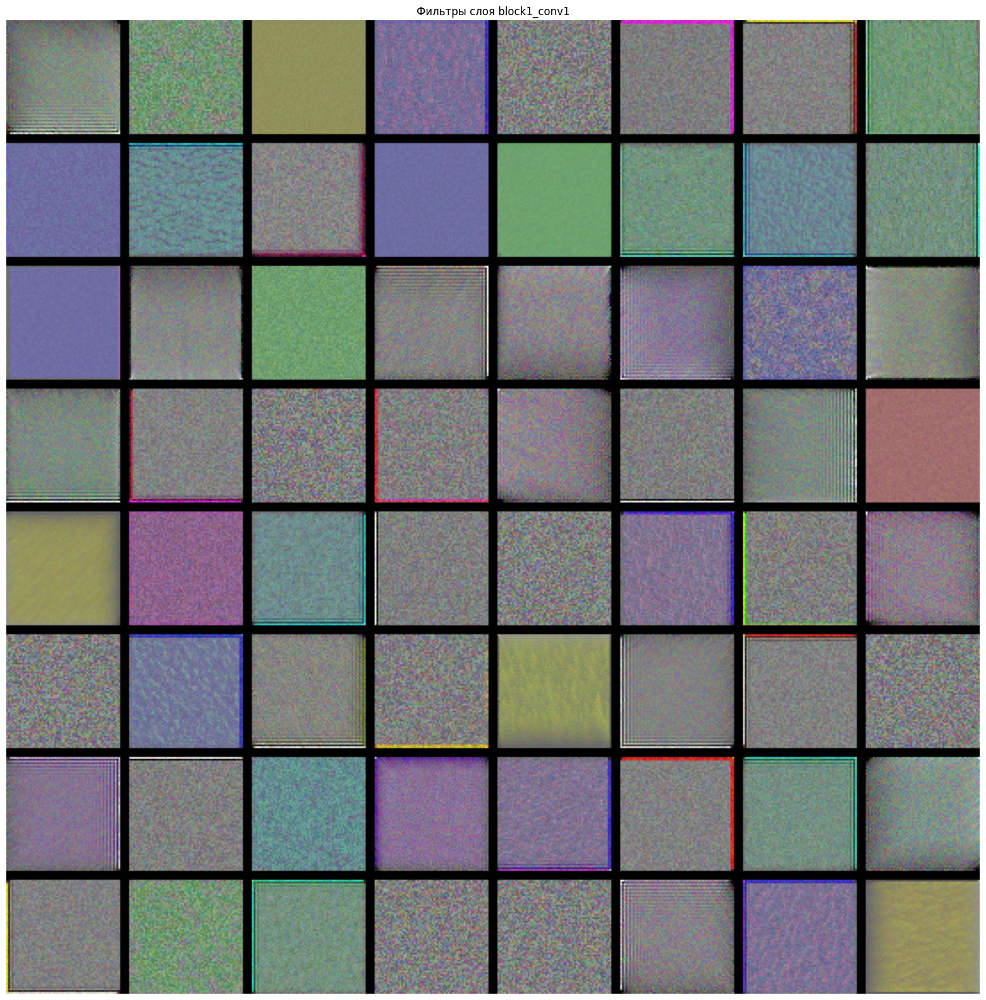

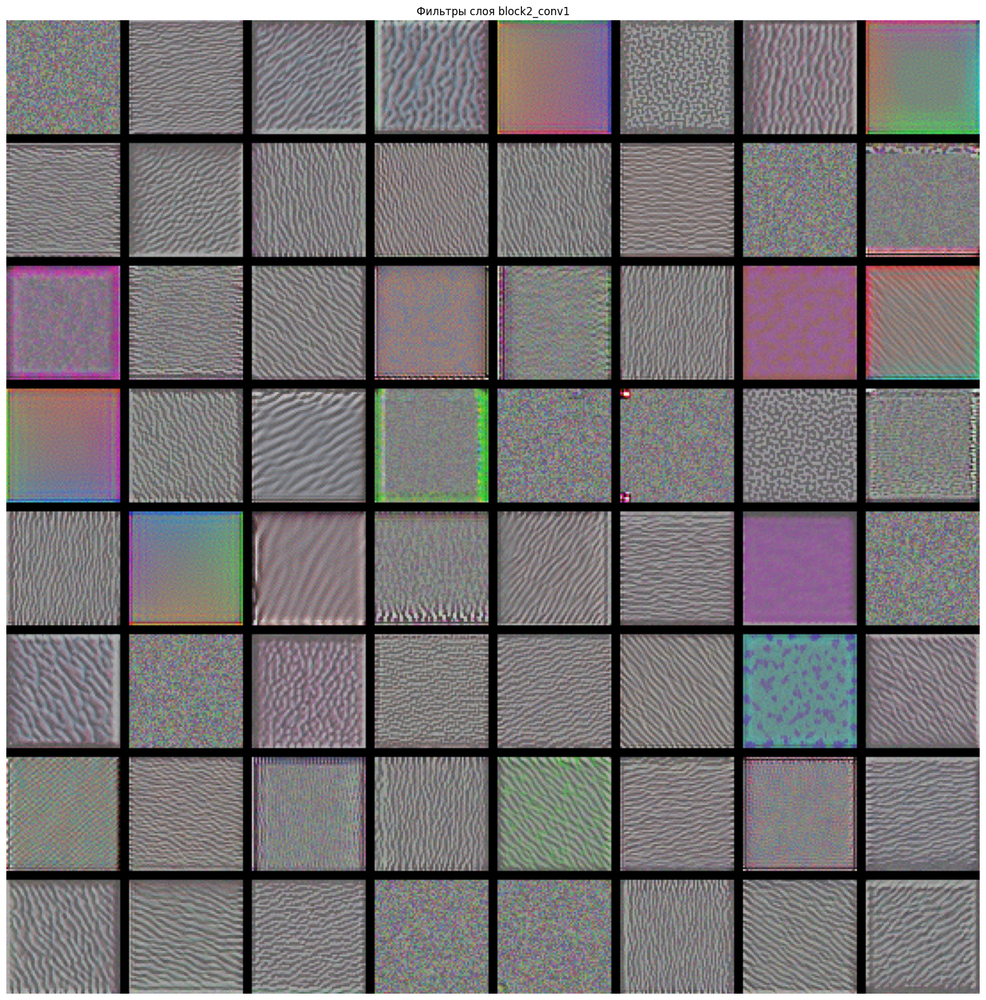

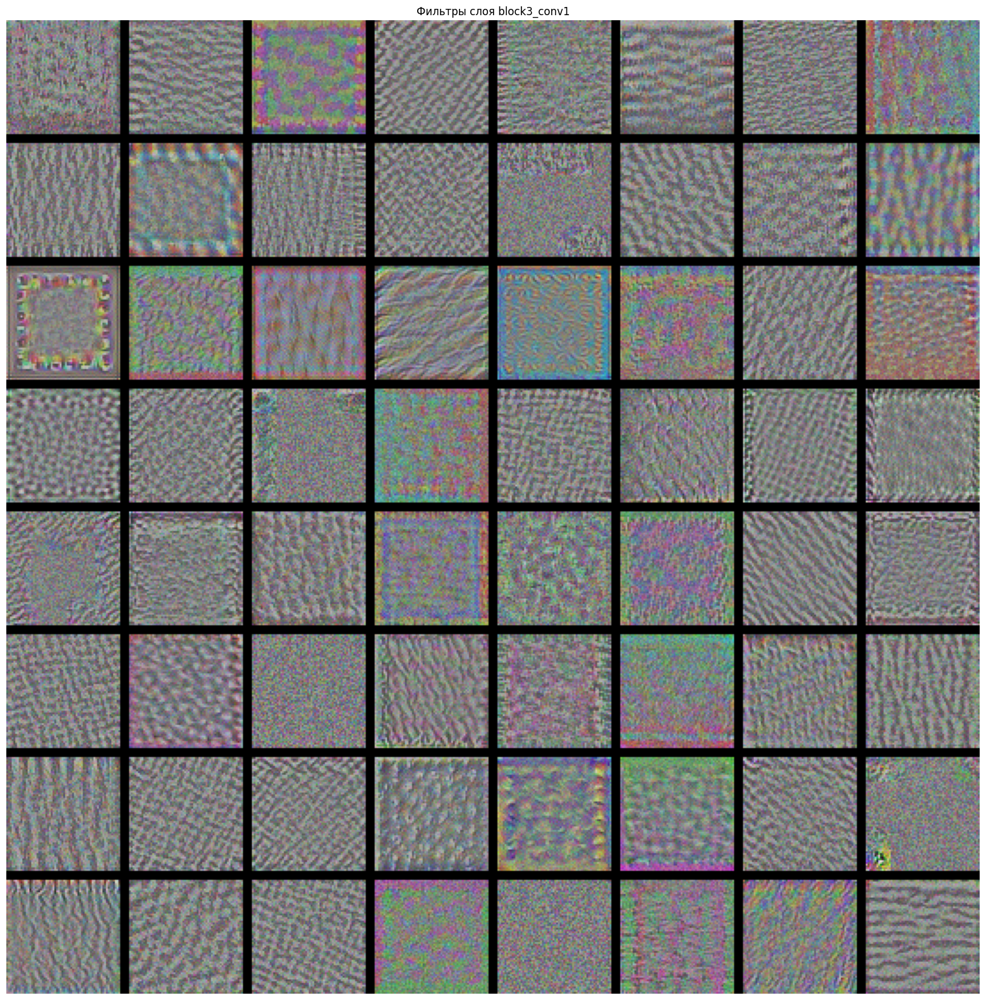

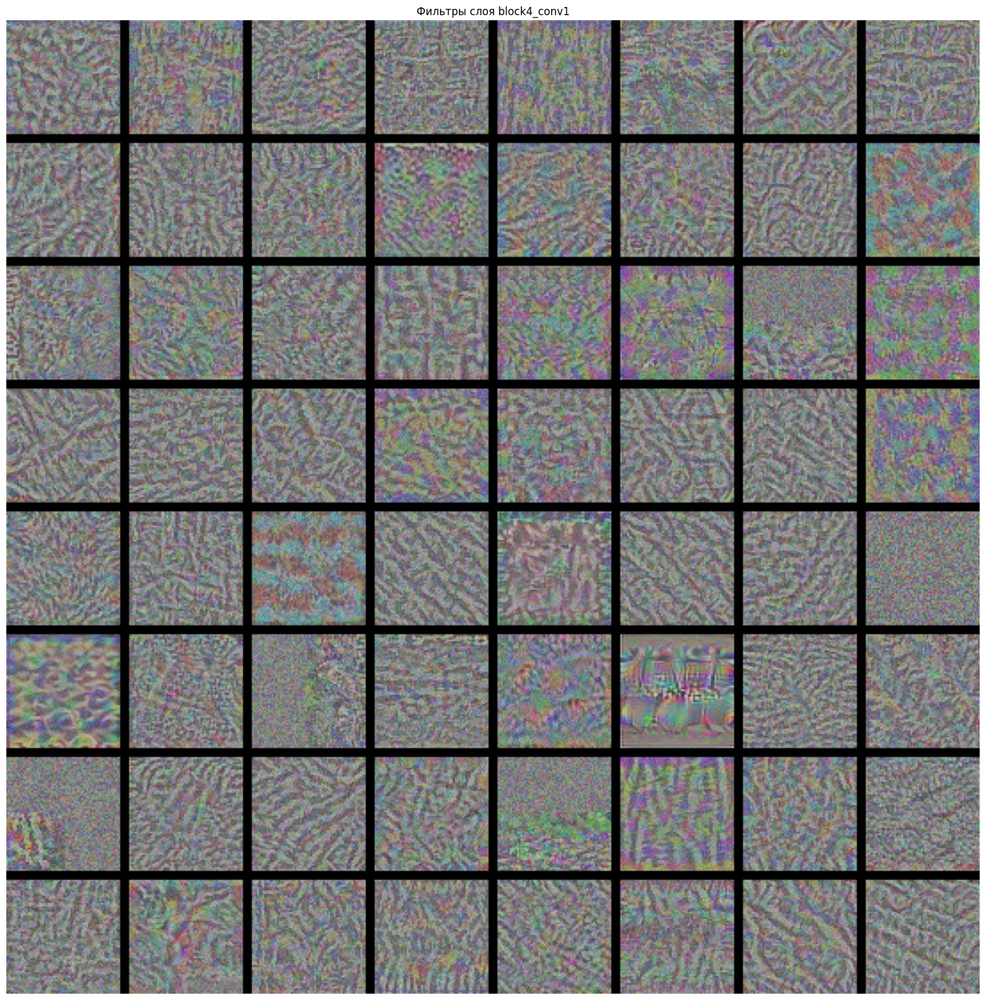

In [11]:
layer_names = ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1']
size = 64
margin = 5

for layer_name in layer_names:
    results = np.zeros((8 * size + 7 * margin, 8 * size + 7 * margin, 3))

    for i in range(8):
        for j in range(8):
            filter_img = generate_pattern(layer_name, i + (j * 8), size=size)
            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            results[horizontal_start:horizontal_end, vertical_start:vertical_end, :] = filter_img

    plt.figure(figsize=(20, 20))
    plt.imshow(results.astype('uint8'))
    plt.title(f'Фильтры слоя {layer_name}')
    plt.axis('off')
    plt.show()